In [8]:
import os

from tqdm.auto import tqdm
import xml.etree.ElementTree as ET

import tensorflow as tf
from tensorflow import keras

import keras_cv
from keras_cv import bounding_box
from keras_cv import visualization

from pathlib import Path

In [11]:
# Test the model on avto_and_number_from_platesmania dataset
class_ids = [
    "License_Plate",
]
class_mapping = dict(zip(range(len(class_ids)), class_ids))

path_images = "raw_datasets/avto_and_number_from_platesmania.com_ua_/avto"

path = Path(path_images)

# Path.absolute().as_posix()

img_paths = [
    file.absolute().as_posix()
    for file in path.iterdir()
    if file.suffix == ".jpg"
]

def load_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    return image


def load_dataset(image_path):
    # Read Image
    image = load_image(image_path)
    return tf.cast(image, tf.float32)

resizing = keras_cv.layers.Resizing(
    640,
    640,
    pad_to_aspect_ratio=True,
    bounding_box_format="xyxy",
)

img_paths = tf.ragged.constant(img_paths)
data = tf.data.Dataset.from_tensor_slices((img_paths))
test_ds = data.map(load_dataset, num_parallel_calls=tf.data.AUTOTUNE)
test_ds = test_ds.map(resizing, num_parallel_calls=tf.data.AUTOTUNE)
test_ds = test_ds.ragged_batch(5, drop_remainder=True)

test_ds = test_ds.prefetch(tf.data.AUTOTUNE)


In [12]:
prediction_decoder = keras_cv.layers.NonMaxSuppression(
    bounding_box_format="xyxy",
    from_logits=True,
    # Decrease the required threshold to make predictions get pruned out
    # iou_threshold=0.2,
    # Tune confidence threshold for predictions to pass NMS
    # confidence_threshold=0.3,
    max_detections=1
)

yolo = keras.models.load_model('yolo_xs_v4_best.keras', compile=False)
yolo.prediction_decoder = prediction_decoder


2024-09-11 20:25:45.345273: E tensorflow/core/util/util.cc:131] oneDNN supports DT_INT64 only on platforms with AVX-512. Falling back to the default Eigen-based implementation if present.


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


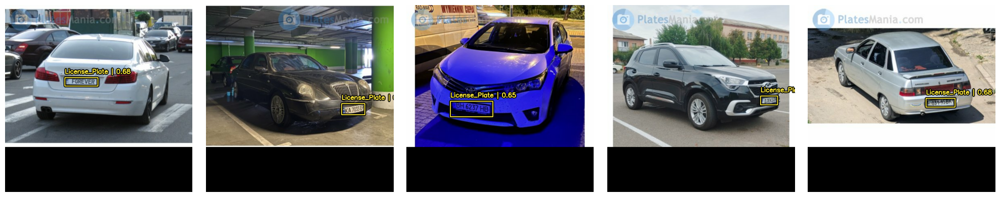

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


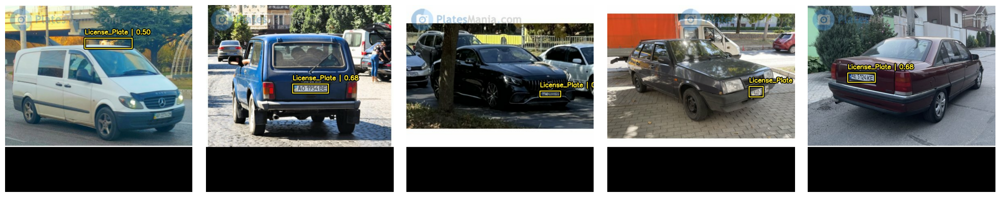

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


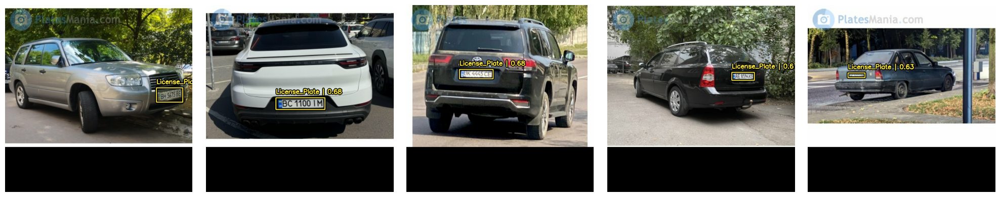

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


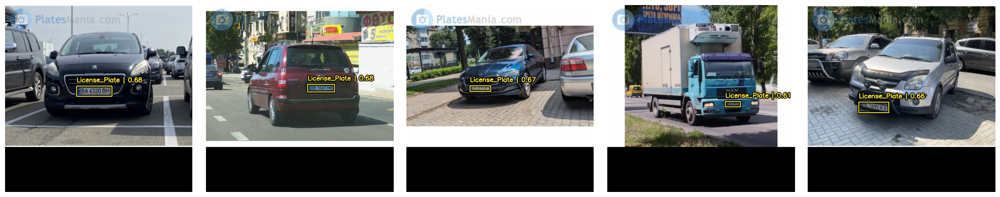

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


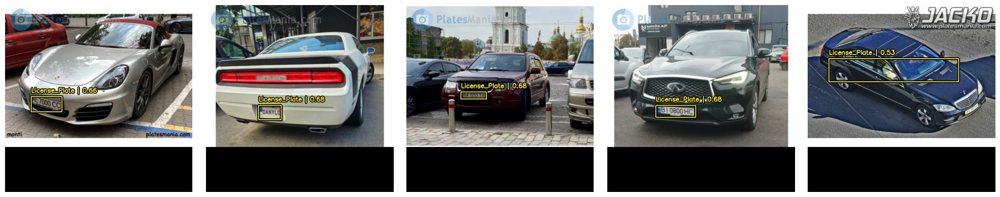

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


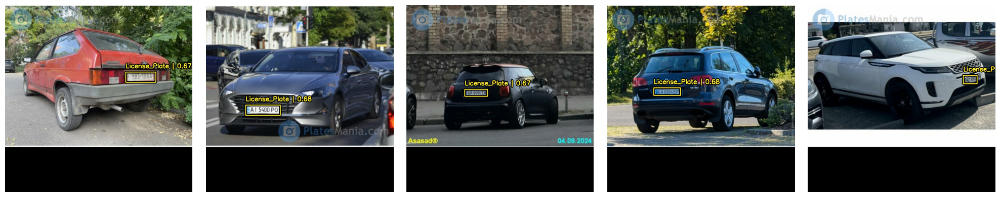

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


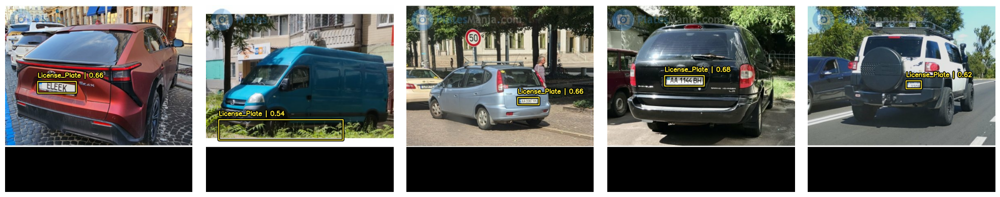

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


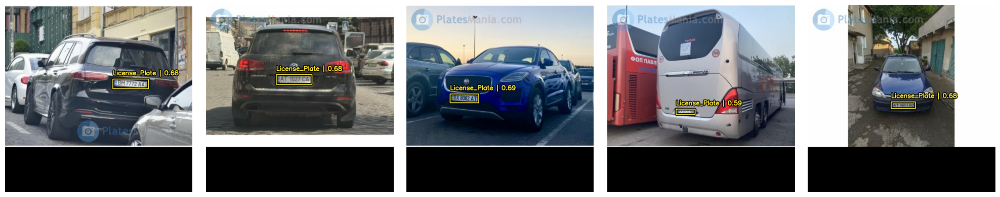

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


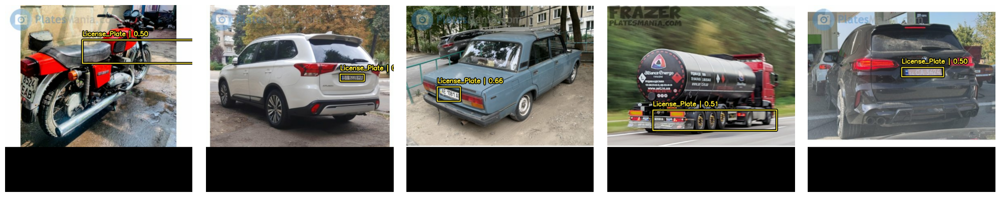

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


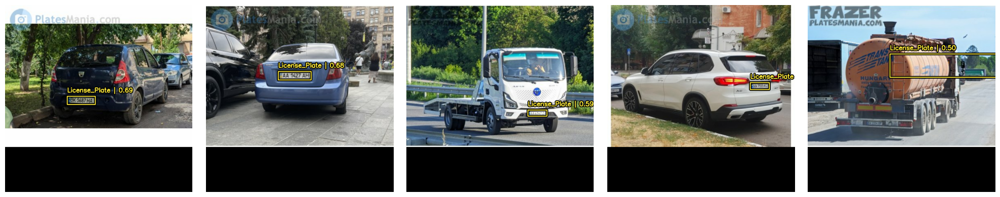

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


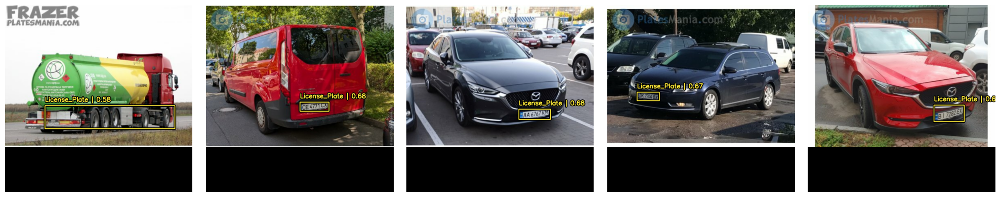

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


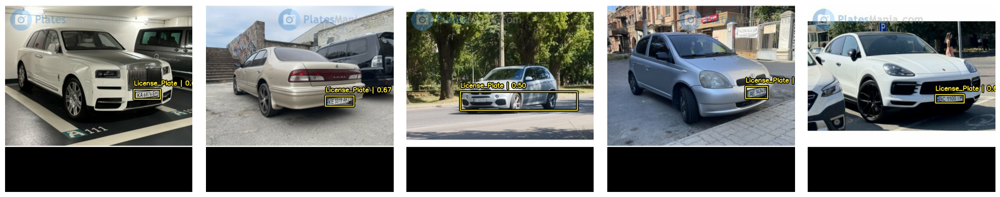

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


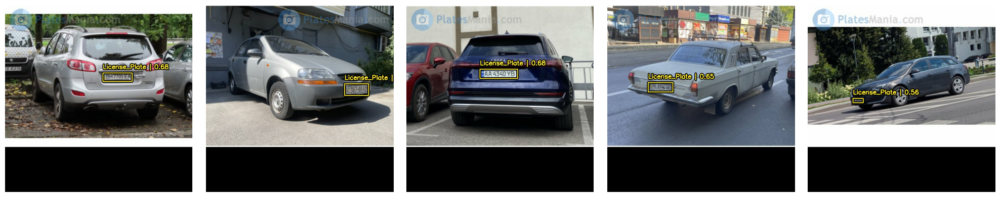

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


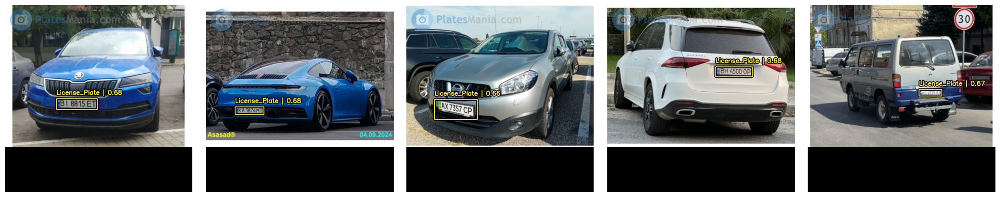

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


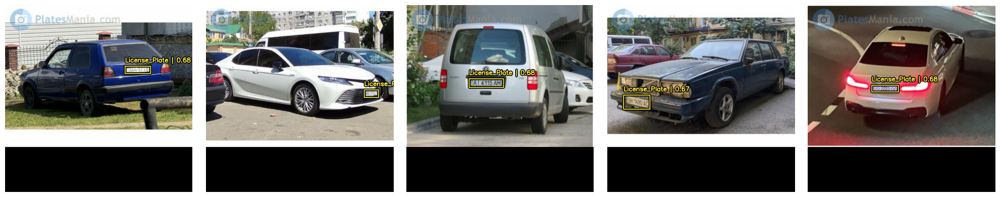

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


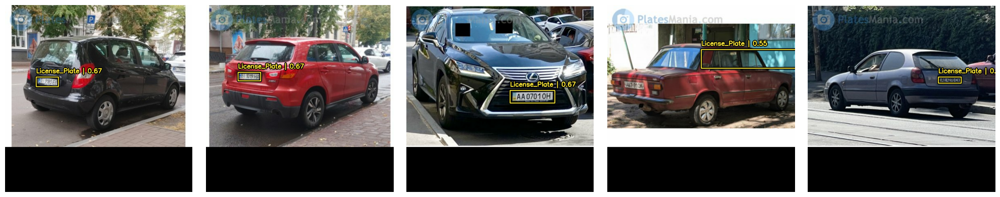

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


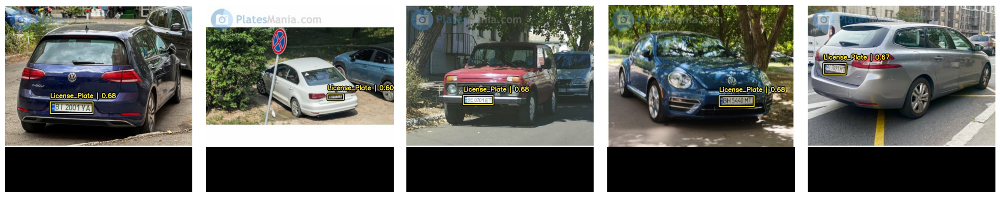

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


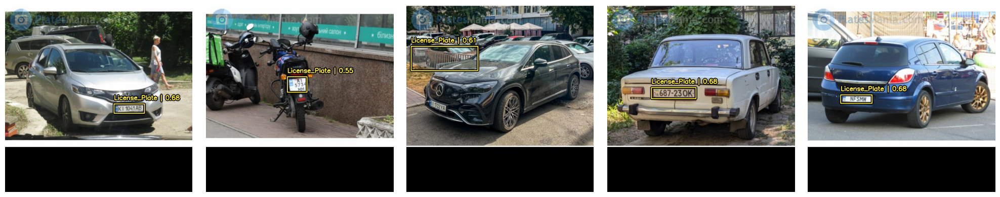

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


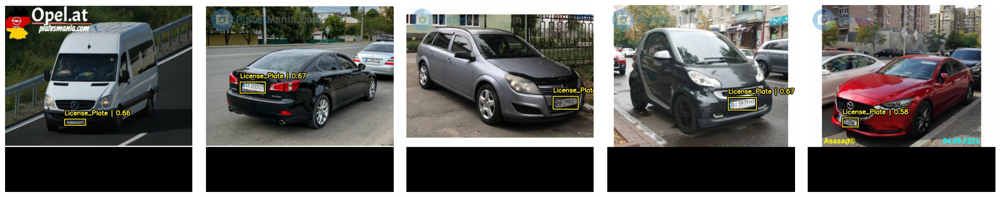

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


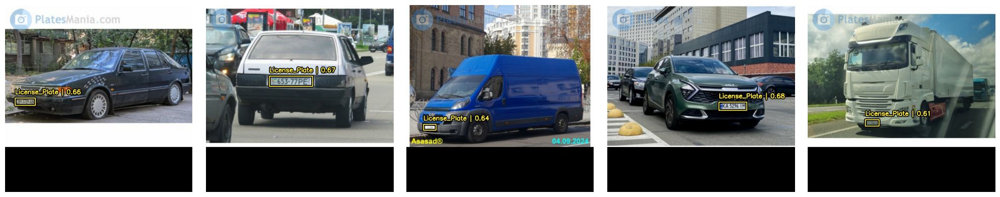

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


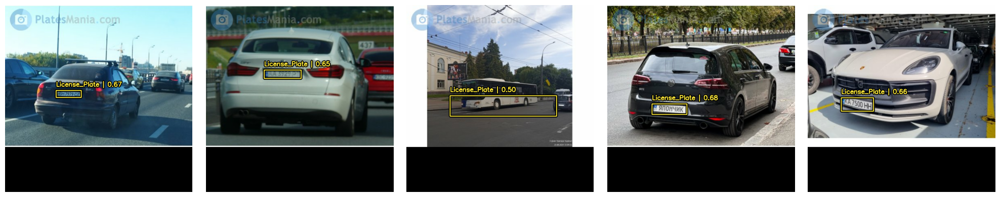

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


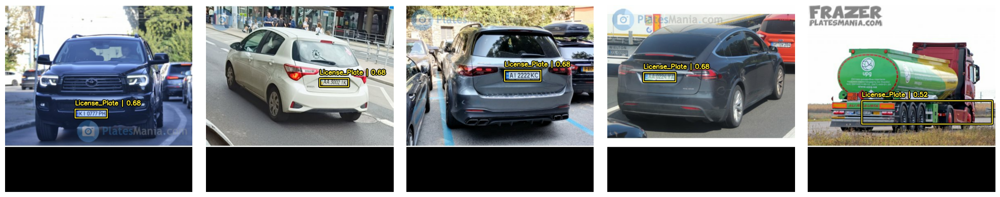

KeyboardInterrupt: 

In [13]:
def visualize_detections(model, dataset, bounding_box_format):
    for images in dataset:
        y_pred = model.predict(images)
        visualization.plot_bounding_box_gallery(
            images,
            value_range=(0, 255),
            bounding_box_format=bounding_box_format,
            y_pred=y_pred,
            scale=4,
            rows=1,
            cols=5,
            show=True,
            font_scale=0.7,
            class_mapping=class_mapping,
        )


visualize_detections(yolo, dataset=test_ds, bounding_box_format="xyxy")